<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Chaotic-Properties" data-toc-modified-id="Chaotic-Properties-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Chaotic Properties</a></span></li><li><span><a href="#Utility-Functions" data-toc-modified-id="Utility-Functions-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Utility Functions</a></span></li><li><span><a href="#Get-Features-of-Ten-Fingerprints" data-toc-modified-id="Get-Features-of-Ten-Fingerprints-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Get Features of Ten Fingerprints</a></span></li><li><span><a href="#Tests" data-toc-modified-id="Tests-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Tests</a></span></li></ul></div>

In [1]:
import os
from tensorflow.keras.applications.resnet import ResNet152, preprocess_input
from tensorflow.keras.models import Model
import numpy as np
import cv2
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from PIL import Image
import time
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim
import pickle
from bitarray import bitarray
from functools import reduce
from operator import mul, concat
from collections import Counter, OrderedDict
from nistrng import pack_sequence, unpack_sequence
from utils import generate_prns, sequence, new_map, new_map_arr

In [15]:
from nistrng import *

for i in range(10):
    key = np.random.rand(8)
    prns = generate_prns(key, 100000)
    prns = (prns * (2**32)).astype(np.uint32).view(np.uint8)
    prns = pack_sequence(prns)
#     prns = "".join(prns.astype(str))
#     with open(f"check-for-randomness/{i+1}.txt", "w") as f:
#         f.write(prns)
    results, exp = run_by_name_battery("maurers_universal", prns, SP800_22R1A_BATTERY)
    print(results.score)

0.9949496015729947
0.9972524846634215
0.9968918862234086
0.9969391636882995
0.9959295346061479
0.9958588205870846
0.9954174359785051
0.9958835795278886
0.9955241306315238
0.9971434607851433


# Chaotic Properties

In [26]:
import pandas as pd
import seaborn as sns
from matplotlib import cm
from matplotlib.colors import ListedColormap

nist_table = pd.read_csv("nistrng.csv")
nist_table = nist_table.set_index("Test")

fig = plt.figure(figsize=(40, 20), dpi=600)
cmap = cm.get_cmap("YlGnBu", 12)
mat = np.array(cmap(np.linspace(0, 1, 10000)))
mat[:75] = np.array([1, 0.43, 0.43, 1])
cmap = ListedColormap(mat)

plt.rcParams.update({"font.size": 18})
ax = sns.heatmap(nist_table.T, cmap=cmap, annot=True, fmt='.4f', annot_kws={"fontsize": 18})
plt.show()

In [ ]:
fig = plt.figure(figsize=(50, 50))
ax1 = fig.add_subplot(111, projection='3d')
# ax2 = fig.add_subplot(122, projection='3d')

n = 2000
a = np.linspace(0, 1, n)
b = np.linspace(0, 1, n)
x = 0.1 * np.ones(n)
y = 0.1 * np.ones(n)
x1 = 0.1 * np.ones(n)
y1 = 0.1 * np.ones(n)

ax1.xaxis.set_tick_params(labelsize=36)
ax1.yaxis.set_tick_params(labelsize=36)
ax1.zaxis.set_tick_params(labelsize=36)

for j in range(2000):
    x, y = new_map_arr(x, y, a, np.ones(a.size) * 0.564)
    x1, y1 = new_map_arr(x1, y1, np.ones(a.size) * 0.115, b)
    if j > 2000-100:
        ax1.scatter(a, x, zs=0, zdir='y', marker=',', color='red', alpha=0.5)
        ax1.scatter(a, y, zs=0.33, zdir='y', marker=',', color='purple', alpha=0.5)
        ax1.scatter(b, x1, zs=0.66, zdir='y', marker=',', color='green', alpha=0.5)
        ax1.scatter(b, y1, zs=1, zdir='y', marker=',', color='blue', alpha=0.5)
plt.legend(["X vs A", "Y vs A", "X vs B", "Y vs B"], fontsize=28, markerscale=5)
plt.show()

In [ ]:
def calc_lyapunov(arr):
    abs_arr = np.abs(np.diff(arr))
    return np.mean(np.log(abs_arr[abs_arr != 0]))

larr = []
for i in np.linspace(0, 1, 100):
    for j in np.linspace(0, 1, 100):
        arr = [*np.random.rand(2)]
        for j in range(1000):
            arr.extend(new_map(arr[-1], arr[-2], a=i, b=j))
        arr = np.abs(arr / np.max(arr))
        larr.append((calc_lyapunov(arr[::2] * (2 ** 32)), calc_lyapunov(arr[1::2] * (2 ** 32))))
    
larr = np.array(larr)

print("Min:", np.min(larr[:, 0]), np.min(larr[:, 1]))
print("Max:", np.max(larr[:, 0]), np.max(larr[:, 1]))
print("Mean:", np.mean(larr[:, 0]), np.mean(larr[:, 1]))

X, Y = np.meshgrid(np.linspace(0, 1, 100), np.linspace(0, 1, 100))
Z = larr[:, 0].reshape(100, 100)
Z2 = larr[:, 1].reshape(100, 100)

fig = plt.figure(figsize=(30, 30))
ax1= fig.add_subplot(121, projection='3d')
ax2 = fig.add_subplot(122, projection='3d')

ax1.set_zlim(20.2, 21)
ax1.set_xlabel("K1")
ax1.set_ylabel("K2")
ax1.plot_surface(X, Y, Z, cmap='YlGnBu')

ax2.set_zlim(20.2, 21)
ax2.set_xlabel("K1")
ax2.set_ylabel("K2")
ax2.plot_surface(X, Y, Z2, cmap='YlGnBu')

plt.subplots_adjust(hspace=0.01, wspace=0.01)

# Utility Functions

In [2]:
def nC(data, ret):
    data = data.flatten()
    ret = ret.flatten()
    
    obs1 = np.sqrt(np.sum(np.power(data, 2)))
    obs2 = np.sqrt(np.sum(np.power(ret, 2)))
    obs3 = np.sum(data * ret)
    
    return obs3 / (obs1 * obs2)

def biterr(data, ret):
    data = data.flatten()
    ret = ret.flatten()
    
    total_bits = data.size * data.itemsize * 8
    bits = np.bitwise_xor(data, ret)
    count = 0
    for i in bits:
        count += format(i, "08b").count('1')
    return count / total_bits

In [3]:
model = ResNet152()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

In [4]:
img = cv2.imread('dataset/1__M_Left_index_finger.BMP')
img = cv2.resize(img,(224,224))     # resize image to match model's expected sizing
img = np.reshape(img,[1,224,224,3]) # return the image with shaping that TF wants.
feature = model.predict(img, verbose=0)[0]
scl = (tf.math.sigmoid(feature).numpy() * (2**32)).astype(np.uint32)

In [5]:
feature.shape

(2048,)

In [6]:
KEY = 0x905068f65172c3606e2b2b3fdda0b9de3d3cd130e90ee1e6927da9c4ffcffede
p = []
for i in range(8):
    p.append((KEY >> (32 * i)) & 0xffffffff)
p = np.array(p)

feature = scl.reshape((-1, 8))
for i in range(len(feature)):
    feature[i] = feature[i] ^ p
feature = feature.flatten()

In [7]:
def get_initial(vec):
    p = []
    for i in range(8):
        p.append(np.bitwise_xor.reduce(vec[i::8]))
    return p

def prns(vec, size, data=None):
    rs = []
    for i in range(len(vec)):
        np.random.seed(vec[i])
        a1 = np.random.randint(0, 256, size, dtype=np.uint8)
        rs.append(a1)
    rs = np.array(rs)
    seq = np.zeros(rs[0].size, dtype=np.uint8)
    for i in range(len(rs)):
        seq = seq ^ rs[i]
    return seq

def substitute(img, r):
    c = img.copy()
    shape = img.shape
    c = c.flatten()
    args = np.argsort(r)
    
    for i in range(c.size):
        c[i], c[args[i]] = c[i] ^ c[args[i]], c[i]
    return c.reshape(shape)

def desubstitute(img, r):
    c = img.copy()
    shape = img.shape
    c = c.flatten()
    args = np.argsort(r)
    
    for i in range(c.size-1, -1, -1):
        c[i], c[args[i]] = c[args[i]], c[i] ^ c[args[i]]
    return c.reshape(shape)


def diffusion(img, r):
    c = img.copy()
    shape = img.shape
    r = r.reshape(shape)
    
    for _ in range(2):
        for i in range(shape[0]):
            c[i] = ((c[i] ^ c[i-1]) + r[i]) % 256
        for j in range(shape[1]):
            c[:, j] = ((c[:, j] ^ c[:, j-1]) + r[:, j]) % 256
        
    return c

def dediffusion(img, r):
    c = img.copy()
    shape = img.shape
    r = r.reshape(shape)
    
    for _ in range(2):
        for j in range(shape[1]-1, -1, -1):
            c[:, j] = ((c[:, j] - r[:, j]) % 256) ^ c[:, j-1] 
        for i in range(shape[0]-1, -1, -1):
            c[i] = ((c[i] - r[i]) % 256) ^ c[i-1]
        
    return c

def DoEnc(img, vec, data=None):
    rs = prns(vec, img.size)
    c = img.copy()
    c = substitute(c, rs)
    c = diffusion(c, rs)
    c = substitute(c, rs)
    c = diffusion(c, rs)
    return c

def DoDec(img, vec, data=None):
    rs = prns(vec, img.size, data=None)
    c = img.copy()
    c = dediffusion(c, rs)
    c = desubstitute(c, rs)
    c = dediffusion(c, rs)
    c = desubstitute(c, rs)
    return c

def embed_data(img, data, seed=10):
    img = img.copy()
    shape = img.shape
    img = img.flatten()
    np.random.seed(seed)
    r = np.random.randint(0, 256, img.size)
    indices = np.argsort(r)
    
    for i in range(len(data)):
        bit = r[i] % 3
        new = (img[indices[i]] & 0b11111000) + (data[i] << bit)
        if bit == 0:
            new += (img[indices[i]] & 0b110) # 6
        elif bit == 1:
            new += (img[indices[i]] & 0b101) # 5
        else:
            new += (img[indices[i]] & 0b011) # 3
        img[indices[i]] = new
    
    return img.reshape(shape)

def extract_data(img, data_len, seed=10):
    img = img.flatten()
    np.random.seed(seed)
    r = np.random.randint(0, 256, img.size)
    indices = np.argsort(r)
    data = np.zeros(data_len, dtype=np.uint8)
    
    for i in range(data_len):
        bit = r[i] % 3
        if bit == 0:
            data[i] = (img[indices[i]] & 0b001)
        elif bit == 1:
            data[i] = (img[indices[i]] & 0b010) >> 1
        else:
            data[i] = (img[indices[i]] & 0b100) >> 2
    
    return data

In [8]:
vec = get_initial(feature)
img = np.array(Image.open("cover/lena.png").convert("RGB"))
data = np.random.randint(0, 2, img.size)
org = img.copy()

start = time.perf_counter()
img = embed_data(img, data)
print("Embedding Time:", time.perf_counter() - start)
print("PSNR after embedding:", psnr(org, img))
print("SSIM after embedding:", ssim(org, img, channel_axis=2), end='\n\n')

start = time.perf_counter()
enc = DoEnc(img, vec)
print("Encryption Time:", time.perf_counter() - start)

start = time.perf_counter()
dec = DoDec(enc, vec)
print("Decryption Time:", time.perf_counter() - start)

start = time.perf_counter()
ret = extract_data(dec, len(data))

print("Extraction Time: ", time.perf_counter() - start)
print("nC:", nC(data, ret))
print("BER:", biterr(data, ret))

fig, ax = plt.subplots(1, 6, figsize=(60, 10))
ax[0].imshow(org)
ax[1].imshow(data.reshape(org.shape) * 255)
ax[2].imshow(img)
ax[3].imshow(enc)
ax[4].imshow(dec)
ax[5].imshow(ret.reshape(org.shape) * 255)

FileNotFoundError: [Errno 2] No such file or directory: 'cover/lena.png'

In [8]:
class NodeTree(object):
    def __init__(self, left=None, right=None):
        self.left = left
        self.right = right

    def children(self):
        return (self.left, self.right)

    def nodes(self):
        return (self.left, self.right)

    def __str__(self):
        return '%s_%s' % (self.left, self.right)

class CustomHuffmanCoding():
    def __generate_sequence(self, vec, length, k=2**32):
        vec = np.array(vec).astype(np.float64) / k
        a1 = generate_prns(vec, length // 4)
        seq = (a1 * k).astype(np.uint32).view(np.uint8)
        return seq[:length]
    
    def __prediction_map_generation(self, image: np.array, confuse=True, mp=None) -> np.array:
        image = image.astype(np.int16)
        p = np.zeros(image.shape, dtype=np.int16)
        if len(image.shape) == 3:
            w, h, d = image.shape
            for k in range(d):
                for i in range(w):
                    for j in range(h):
                        if i == 0 and j == 0:
                            p[i, j, k] = image[i, j, k]
                        elif i == 0 and j > 0:
                            p[i, j, k] = image[i, j, k] - image[i, j-1, k]
                        elif i > 0 and j == 0:
                            p[i, j, k] = image[i, j, k] - image[i-1, j, k]
                        else:
                            a = int(image[i-1, j-1, k])
                            b = int(image[i, j-1, k])
                            c = int(image[i-1, j, k])
                            if a >= max(b, c):
                                p[i, j, k] = image[i, j, k] - min(b, c)
                            elif a <= min(b, c):
                                p[i, j, k] = image[i, j, k] - max(b, c)
                            else:
                                p[i, j, k] = image[i, j, k] - (b+c-a)
        else:
            w, h = image.shape
            for i in range(w):
                for j in range(h):
                    if i == 0 and j == 0:
                        p[i, j] = image[i, j]
                    elif i == 0 and j > 0:
                        p[i, j] = image[i, j] - image[i, j-1]
                    elif i > 0 and j == 0:
                        p[i, j] = image[i, j] - image[i-1, j]
                    else:
                        a = int(image[i-1, j-1])
                        b = int(image[i, j-1])
                        c = int(image[i-1, j])
                        if a >= max(b, c):
                            p[i, j] = image[i, j] - min(b, c)
                        elif a <= min(b, c):
                            p[i, j] = image[i, j] - max(b, c)
                        else:
                            p[i, j] = image[i, j] - (b+c-a)
        if confuse:
            args = np.argsort(mp[:p.size])
            p = p.flatten()[args].reshape(p.shape)
        return p

    def __inverse_prediction_map(self, p: np.array, confuse=True, mp=None) -> np.array:
        if confuse:
            args = np.argsort(mp[:p.size])
            args = np.argsort(args)
            p = p.flatten()[args].reshape(p.shape)

        img = np.zeros(p.shape, dtype=np.uint8)
        if len(p.shape) == 3:
            w, h, d = img.shape
            for k in range(d):
                for i in range(w):
                    for j in range(h):
                        if i == 0 and j == 0:
                            img[i, j, k] = p[i, j, k]
                        elif i == 0 and j > 0:
                            img[i, j, k] = p[i, j, k] + img[i, j-1, k]
                        elif i > 0 and j == 0:
                            img[i, j, k] = p[i, j, k] + img[i-1, j, k]
                        else:
                            a = int(img[i-1, j-1, k])
                            b = int(img[i, j-1, k])
                            c = int(img[i-1, j, k])
                            if a >= max(b, c):
                                img[i, j, k] = p[i, j, k] + min(b, c)
                            elif a <= min(b, c):
                                img[i, j, k] = p[i, j, k] + max(b, c)
                            else:
                                img[i, j, k] = p[i, j, k] + (b+c-a)
        else:
            w, h = img.shape
            for i in range(w):
                for j in range(h):
                    if i == 0 and j == 0:
                        img[i, j] = p[i, j]
                    elif i == 0 and j > 0:
                        img[i, j] = p[i, j] + img[i, j-1]
                    elif i > 0 and j == 0:
                        img[i, j] = p[i, j] + img[i-1, j]
                    else:
                        a = int(img[i-1, j-1])
                        b = int(img[i, j-1])
                        c = int(img[i-1, j])
                        if a > max(b, c):
                            img[i, j] = p[i, j] + min(b, c)
                        elif a < min(b, c):
                            img[i, j] = p[i, j] + max(b, c)
                        else:
                            img[i, j] = p[i, j] + (b+c-a)
        return (img % 256).astype(np.uint8)
    
    def __generate_initial_hct(self, p):
        counter = Counter(p.flatten())
        codes = self.__generate_codes(counter, dtype=np.int16)
        L = dict(map(lambda x: (x[0], len(x[1])), codes.items()))
        V = OrderedDict()
        for i, (k, v) in enumerate(L.items()):
            V[v] = V.get(v, []) + [i]
        return codes, L, V


    def __generate_tvhct(self, codes, v, l: dict, timeFrame=time.time()):
        t = round(timeFrame)
        np.random.seed(t)
        for i in v:
            np.random.shuffle(v[i])
        v = list(map(lambda x: x[1], v.items()))
        v = reduce(concat, v)
        newL = []
        keys = list(l.keys())
        for i in v:
            newL.append((keys[i], codes[keys[v[i]]]))

        newDict = OrderedDict()
        newL = dict(newL)

        for i in codes.keys():
            newDict[i] = newL[i]
        return newDict

    def __huffman_code_tree(self, node, dtype=str, left=True, binString=''):
        if type(node) is dtype:
            return {node: binString}
        (l, r) = node.children()
        d = dict()
        d.update(self.__huffman_code_tree(l, dtype=dtype, left=True, binString=binString + '0'))
        d.update(self.__huffman_code_tree(r, dtype=dtype, left=False, binString=binString + '1'))
        return d


    def __generate_codes(self, counter, dtype=str):
        freq = sorted(counter.items(), key=lambda x: x[1], reverse=True)
        nodes = freq

        while len(nodes) > 1:
            (key1, c1) = nodes[-1]
            (key2, c2) = nodes[-2]
            nodes = nodes[:-2]
            node = NodeTree(key1, key2)
            nodes.append((node, c1 + c2))

            nodes = sorted(nodes, key=lambda x: x[1], reverse=True)

        huffmanCode = self.__huffman_code_tree(nodes[0][0], dtype=dtype)
        return dict(sorted(huffmanCode.items(), key=lambda x: len(x[1])))
    
    def encode(self, p, key):
        seq = self.__generate_sequence(key, reduce(mul, self.shape))
        p = self.__prediction_map_generation(p, confuse=True, mp=seq)
        
        self.codes = []
        self.codes_inv = []
        self.lengths = []
        self.length_of_codes = [[], [], []]
        
        full = ""
        for channel in range(3):
            codes_r, L_r, V_r = self.__generate_initial_hct(p[:, :, channel])
            self.codes.append(self.__generate_tvhct(codes_r, V_r, L_r, timeFrame=self.timeFrame))
            self.codes_inv.append(dict(zip(self.codes[channel].values(), self.codes[channel].keys())))

            string = ""
            a = p[:, :, channel].flatten()
            for i in range(len(a)):
                string += self.codes[channel][a[i]]
                self.length_of_codes[channel].append(len(self.codes[channel][a[i]]))
            full += string
            self.lengths.append(len(string))
        
        data = np.array(bitarray(full).tolist())
        data = unpack_sequence(data).astype(np.uint8)
        ra = seq.astype(np.uint8)
        for _ in range(2):
            for i in range(len(data)):
                data[i] = (data[i] + data[i-1] + ra[i]) % 256
    
        return data
    
    def decode(self, data, key):
        seq = self.__generate_sequence(key, reduce(mul, self.shape))
        
        data = np.array(data)
        ra = seq.astype(np.uint8)
        for _ in range(2):
            for i in range(len(data)-1, -1, -1):
                data[i] = (data[i] - data[i-1] - ra[i]) % 256
    
        n = bitarray()
        n.extend(pack_sequence(data))
        data = n
        full_data = data.to01()
        ret = np.zeros(self.shape)
        for channel in range(3):
            start = 0 if channel == 0 else sum(self.lengths[:channel])
            data = full_data[start: start + self.lengths[channel]]
            i = 0
            count = 0
            pixels = []
            while i < len(data):
                j = i + self.length_of_codes[channel][count]
                if data[i: j] in self.codes_inv[channel]:
                    pixels.append(self.codes_inv[channel][data[i: j]])
                i = j
                count += 1
            pixels = np.array(pixels)[:reduce(mul, self.shape[:2])].reshape(self.shape[:2])
            ret[:, :, channel] = pixels
        ret = self.__inverse_prediction_map(ret, confuse=True, mp=seq)
        return ret
    
    def get_codes_from_file(f):
        self.codes = pickle.load(f)
        self.codes_inv = dict(zip(self.codes.values(), self.codes.keys()))
        
    def save_codes_to_file(f):
        pickle.dump(self.codes, f)
    
    def __init__(self, shape, timeFrame=None):
        self.shape = shape
        self.timeFrame = timeFrame if timeFrame else time.time()

In [9]:
vec = get_initial(feature)
img = np.array(Image.open("cover/volume-0_slice_0.jpg").resize((512, 512)).convert("RGB"))
data = np.random.randint(0, 2, img.size)
org = img.copy()

start = time.perf_counter()
img = embed_data(img, data)
print("Embedding Time:", time.perf_counter() - start)
print("PSNR after embedding:", psnr(org, img))
print("SSIM after embedding:", ssim(org, img, channel_axis=2), end='\n\n')

start = time.perf_counter()
encoder = CustomHuffmanCoding(shape=img.shape)
enc = encoder.encode(img, vec)
print("Encryption Time:", time.perf_counter() - start)

start = time.perf_counter()
dec = encoder.decode(enc, vec)
print("Decryption Time:", time.perf_counter() - start)

vec2 = vec.copy()
vec2[0] += 1
dec2 = encoder.decode(enc, vec2)

start = time.perf_counter()
ret = extract_data(dec, len(data))

print("Extraction Time: ", time.perf_counter() - start)
print("nC:", nC(data, ret))
print("BER:", biterr(data, ret))
print("CR:", len(enc) / (img.size))

fig, ax = plt.subplots(1, 3, figsize=(30, 10))
ax[0].imshow(img)
ax[1].imshow(dec)
ax[2].imshow(dec2)

Embedding Time: 3.475627700000004
PSNR after embedding: 42.710724522020826
SSIM after embedding: 0.9119449275333693



C:\Users\ADMIN\AppData\Local\Temp/ipykernel_2152/2312287941.py:204: RuntimeWarning: overflow encountered in ubyte_scalars
  data[i] = (data[i] + data[i-1] + ra[i]) % 256


Encryption Time: 5.8092247999999955


C:\Users\ADMIN\AppData\Local\Temp/ipykernel_2152/2312287941.py:215: RuntimeWarning: overflow encountered in ubyte_scalars
  data[i] = (data[i] - data[i-1] - ra[i]) % 256


Decryption Time: 5.6859678


ValueError: cannot reshape array of size 59777 into shape (512,512)

# Get Features of Ten Fingerprints

In [10]:
fingerprints = []
files = os.listdir("./dataset")
for file in files:
    picPath = os.path.join("dataset", file)
    img = np.array(Image.open(picPath).convert("RGB").resize((224, 224)))
    fingerprints.append(img)
fingerprints = np.array(fingerprints)

data = model.predict(fingerprints, verbose=0)[:1].flatten()
data = pack_sequence(np.round(data * (2**32)).astype(np.uint32).view(np.uint8))

In [11]:
print(data.shape)

(65536,)


# Tests

In [12]:
from tqdm.notebook import tqdm
from scipy.stats import pearsonr
import pandas as pd
import logging

def runTests(path, data):
    try:
        files = os.listdir(path)
        results = []
        for picName in tqdm(files, desc="Tests"):
            try:
                picPath = os.path.join(path, picName)
                img = np.array(Image.open(picPath).convert("RGB"))
                org = img.copy()
                img = embed_data(img, data)
                img2 = img.copy()
                img2[np.random.randint(0, min(img2.shape), 2)] ^= 1
                encoder = CustomHuffmanCoding(shape=img.shape)
                encoder2 = CustomHuffmanCoding(shape=img.shape)
                start = time.perf_counter()
                enc = encoder.encode(img, vec)
                enc_time = time.perf_counter() - start
                enc2 = encoder2.encode(img2, vec)

                start = time.perf_counter()
                dec = encoder.decode(enc, vec)
                dec_time = time.perf_counter() - start

                ext = extract_data(dec, len(data))
                n, _ = np.histogram(org.flatten(), bins=256)
                n = n[n > 0] / org.size
                entropy_plain = np.sum(-n * np.log2(n))

                n, _ = np.histogram(enc, bins=256)
                n = n / enc.size
                entropy = np.sum(-n * np.log2(n))
                
                seed = np.random.randint(0, 256, org.size-1)
                seed = np.argsort(seed)
                corr_plain = pearsonr(org.flatten()[seed[:5000]], org.flatten()[seed[:5000]+1])[0]
                correlation = pearsonr(enc, np.roll(enc, 1))[0]
                cr = len(enc) / (img.size)
                length = min(enc.size, enc2.size)
                npcr = enc[enc2[:length] != enc[:length]].size / length
                uaci = np.sum(np.abs(enc2[:length].astype(np.int32) - enc[:length].astype(np.int32)) / 255) / length
                nc = nC(data, ext)
                ber = biterr(data, ext)

                print(f"{picName=}\n{psnr(org, img)=}\n{ssim(org, img, channel_axis=2)=}\n{npcr=}\n{uaci=}\n{entropy_plain=}\n{entropy=}\n{corr_plain=}\n{correlation=}\n{cr=}\n{nc=}\n{ber=}\n{enc_time=}\n{dec_time=}")
                fig, ax = plt.subplots(1, 3, figsize=(40, 10))
                ax[0].imshow(org)
                ax[1].hist(org.flatten(), bins=256)
                ax[2].bar(np.arange(0, 256), n*enc.size)
                plt.show()

                indices = np.random.randint(0, org.size-1, 5000)
                fig, ax = plt.subplots(1, 3, figsize=(30, 10))
                ax[0].imshow(img)
                ax[1].scatter(org.flatten()[indices], np.roll(org.flatten()[indices+1], 1))
                indices = np.random.randint(0, enc.size-1, 5000)
                ax[2].scatter(enc.flatten()[indices], np.roll(enc.flatten()[indices+1], 1))
                plt.show()

                results.append((picName, "x".join(np.array(org.shape, dtype=str)), psnr(org, img), ssim(org, img, channel_axis=2), npcr, uaci, entropy_plain, entropy, corr_plain, correlation, cr, nc, ber, enc_time, dec_time))
            except Exception as e:
                logging.exception(e)
    except KeyboardInterrupt as e:
        pass
    finally:
        results = pd.DataFrame(results, columns=["Image", "Size", "PSNR", "SSIM", "NPCR", "UACI", "Entropy Plain", "Entropy", "Correlation Plain", "Correlation", "CR", "NC", "BER", "Enc time", "Dec time"])
        results.to_csv(f"results-{path}.csv", index=False)
        return results

In [ ]:
runTests("sea-animals-dataset", data)

In [ ]:
runTests("spleen", data)

Tests:   0%|          | 0/13486 [00:00<?, ?it/s]

C:\Users\ADMIN\AppData\Local\Temp/ipykernel_2152/2312287941.py:204: RuntimeWarning: overflow encountered in ubyte_scalars
  data[i] = (data[i] + data[i-1] + ra[i]) % 256
C:\Users\ADMIN\AppData\Local\Temp/ipykernel_2152/2312287941.py:215: RuntimeWarning: overflow encountered in ubyte_scalars
  data[i] = (data[i] - data[i-1] - ra[i]) % 256


picName='1.png'
psnr(org, img)=55.90337912352159
ssim(org, img, channel_axis=2)=0.9975756186450789
npcr=0.9961227568504717
uaci=0.33403295184284054
entropy_plain=1.8081159098984028
entropy=7.9992007017781654
corr_plain=0.9652080814888171
correlation=0.0016948920048451325
cr=0.28237024943033856
nc=1.0
ber=0.0
enc_time=4.219196299999965
dec_time=3.0566848999999934


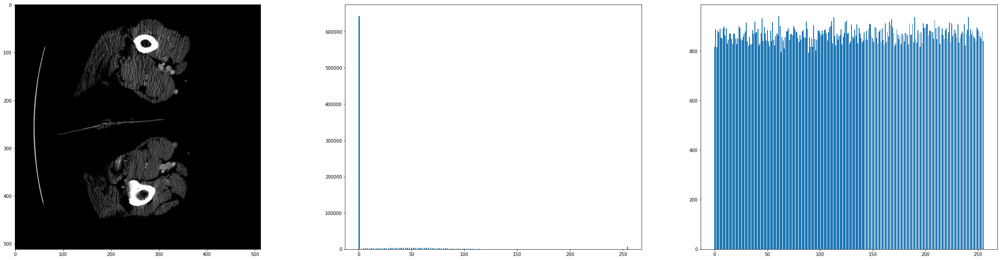

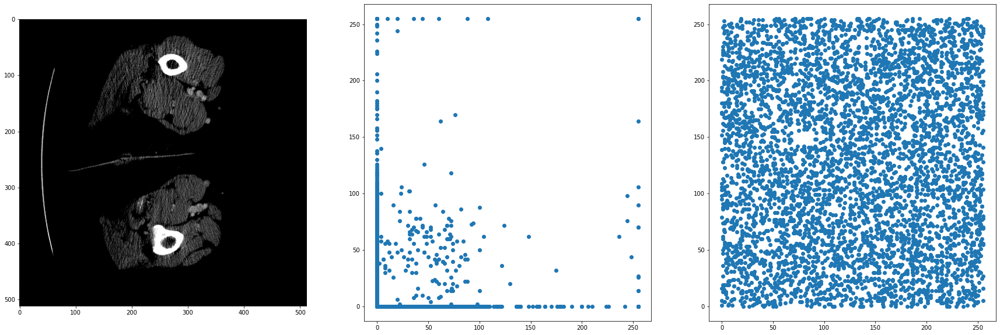

picName='10.png'
psnr(org, img)=55.76808652626774
ssim(org, img, channel_axis=2)=0.9976466089568786
npcr=0.9960912475110381
uaci=0.3338514448286457
entropy_plain=2.0124761459832654
entropy=7.99917195339871
corr_plain=0.9801224977988289
correlation=0.0012767197978136601
cr=0.2937571207682292
nc=1.0
ber=0.0
enc_time=4.2866449999999645
dec_time=3.2513770000000477


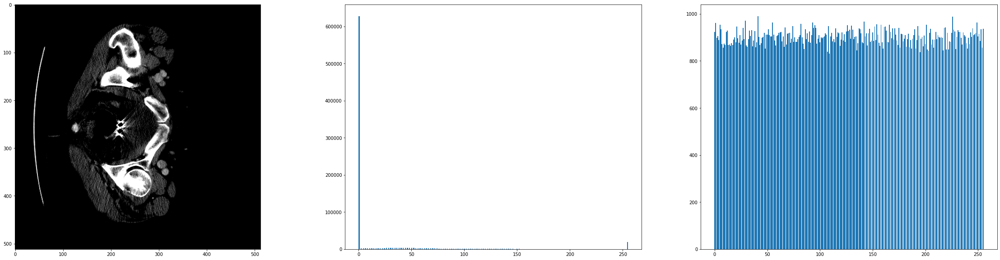

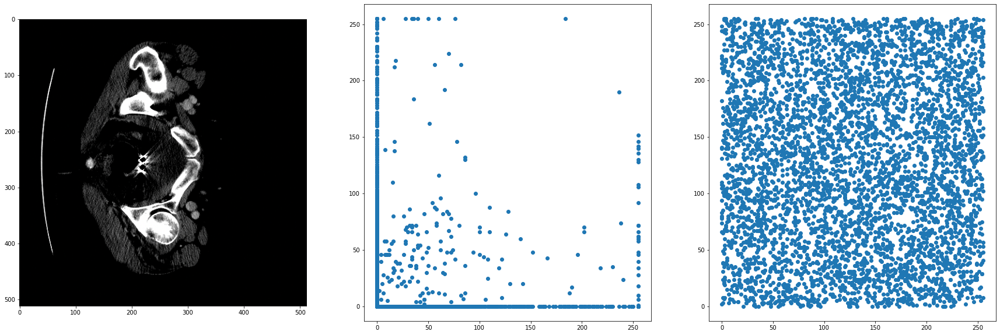

picName='100.png'
psnr(org, img)=55.88134706482461
ssim(org, img, channel_axis=2)=0.9975353368540807
npcr=0.9957892367639957
uaci=0.33400533797309834
entropy_plain=1.6921694775182454
entropy=7.999041053433763
corr_plain=0.9726990431038437
correlation=-0.0014079009057194431
cr=0.2711779276529948
nc=1.0
ber=0.0
enc_time=4.121094800000037
dec_time=3.0080666000000065


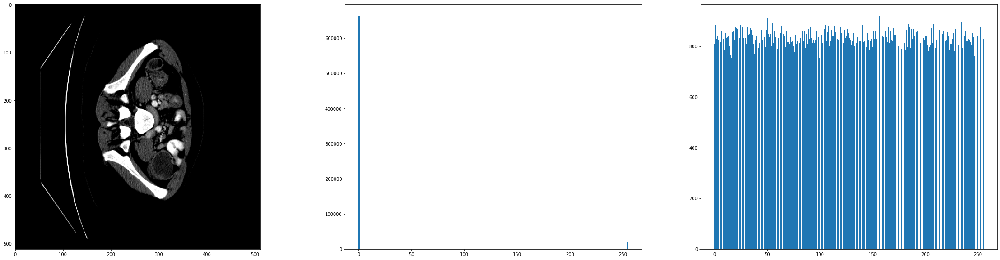

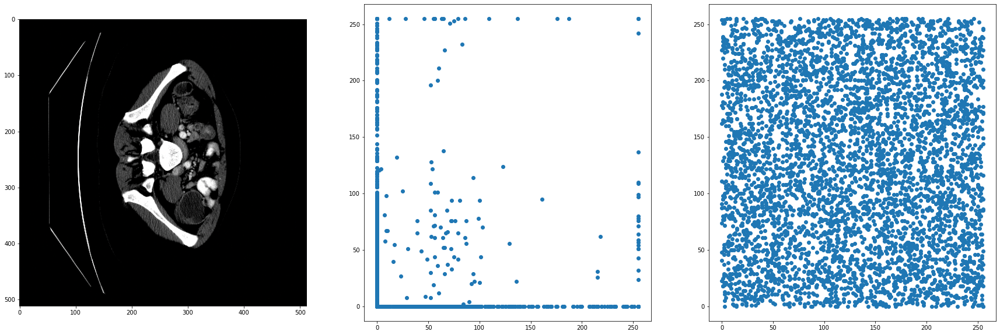

picName='1000.png'
psnr(org, img)=55.818506981074876
ssim(org, img, channel_axis=2)=0.997639167327726
npcr=0.9961613359068036
uaci=0.33448832004022405
entropy_plain=2.1304406971218413
entropy=7.99920925967446
corr_plain=0.9816422236338702
correlation=0.0007750904954495493
cr=0.2951456705729167
nc=1.0
ber=0.0
enc_time=4.2625765999999885
dec_time=3.1627937999999745


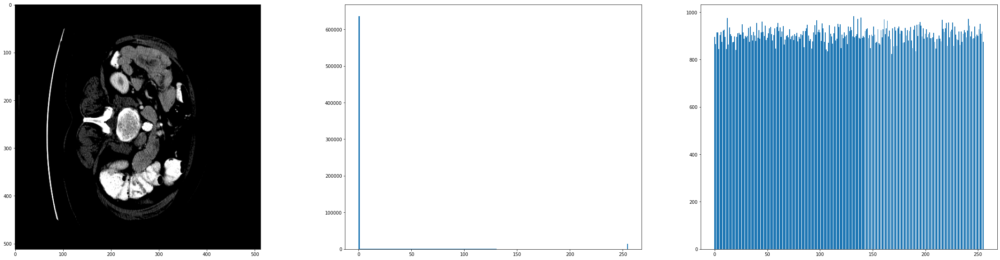

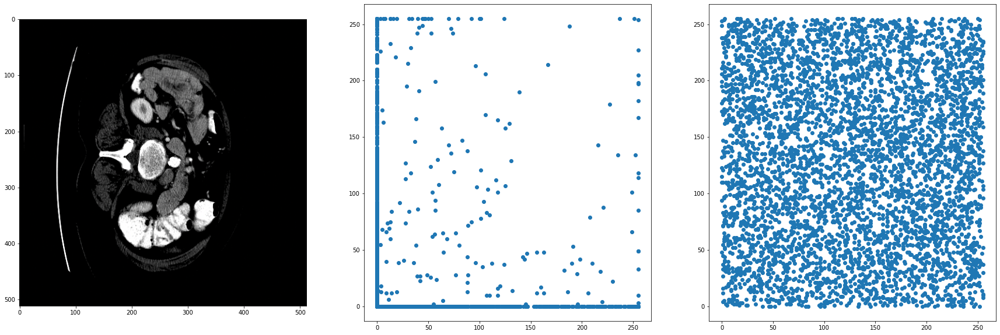

picName='10000.png'
psnr(org, img)=56.10575625377081
ssim(org, img, channel_axis=2)=0.9975194589872697
npcr=0.9961082662765179
uaci=0.335492691882898
entropy_plain=1.4113539717565984
entropy=7.999113482457284
corr_plain=0.9773897672239368
correlation=0.00022457206617136063
cr=0.26073455810546875
nc=1.0
ber=0.0
enc_time=4.110367499999995
dec_time=3.387608300000011


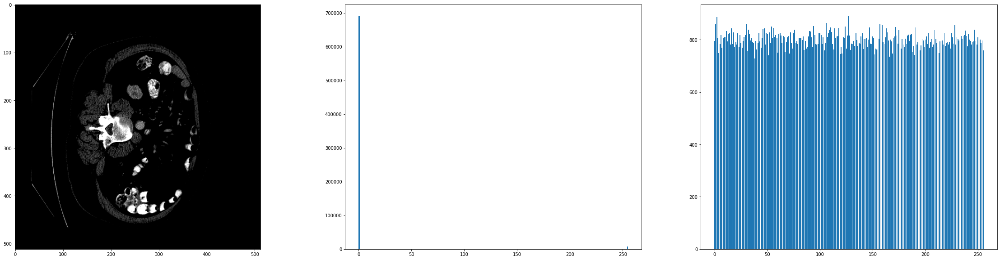

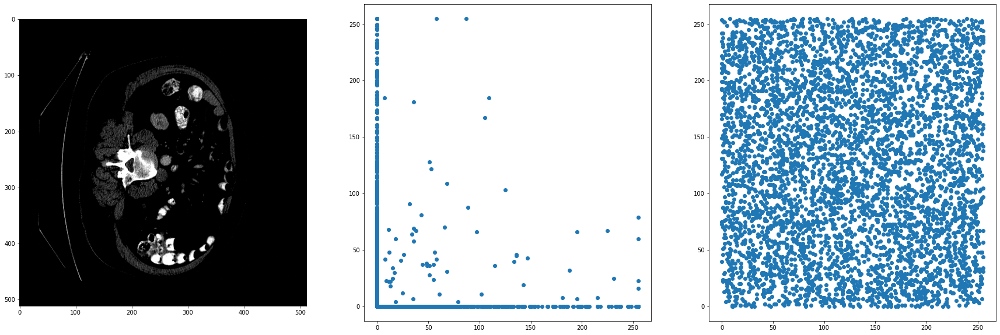

picName='10001.png'
psnr(org, img)=56.08608885495573
ssim(org, img, channel_axis=2)=0.9975254776438911
npcr=0.9962509760557164
uaci=0.3346084180009067
entropy_plain=1.428580343243888
entropy=7.999062717012011
corr_plain=0.9785504881354172
correlation=-0.0008554736166076574
cr=0.2621803283691406
nc=1.0
ber=0.0
enc_time=4.101209299999994
dec_time=2.936989199999971


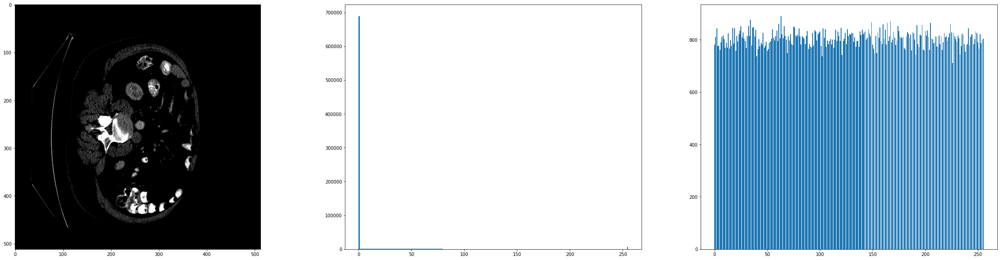

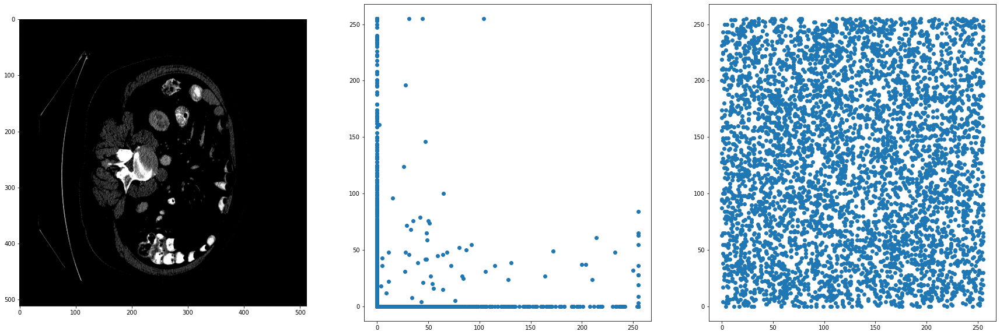

picName='10002.png'
psnr(org, img)=56.10215485131923
ssim(org, img, channel_axis=2)=0.9975263367010757
npcr=0.9960460152835786
uaci=0.33396313163332964
entropy_plain=1.4357864176890058
entropy=7.999169610081182
corr_plain=0.9745928594391685
correlation=7.215948468526661e-05
cr=0.2627398173014323
nc=1.0
ber=0.0
enc_time=4.100154300000042
dec_time=2.926227200000028


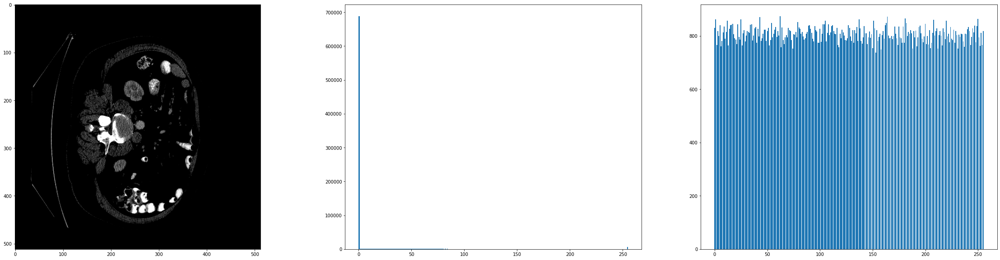

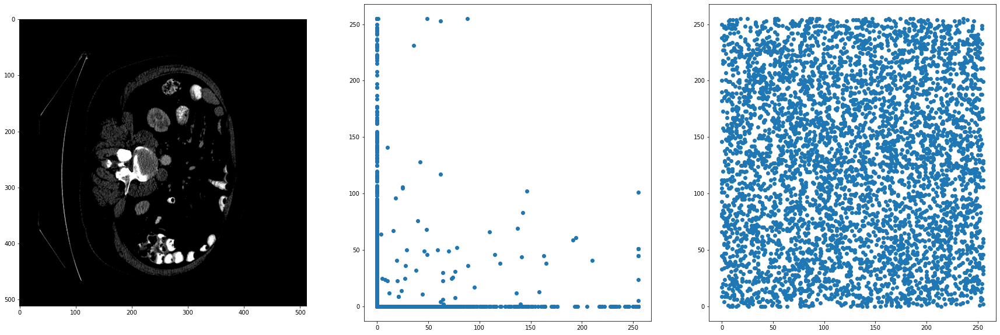

picName='10003.png'
psnr(org, img)=56.10212023694153
ssim(org, img, channel_axis=2)=0.9975387529809895
npcr=0.9960317077639662
uaci=0.33511713141624716
entropy_plain=1.4587153811644318
entropy=7.9990152862873565
corr_plain=0.9769180977497357
correlation=-0.000611413101536361
cr=0.26371510823567706
nc=1.0
ber=0.0
enc_time=4.0931426000000215
dec_time=2.994617500000004


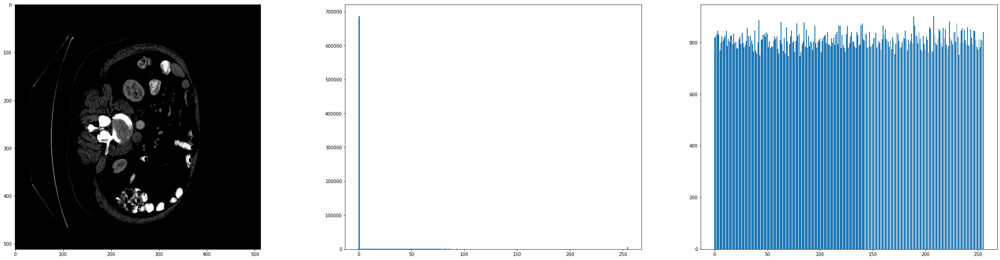

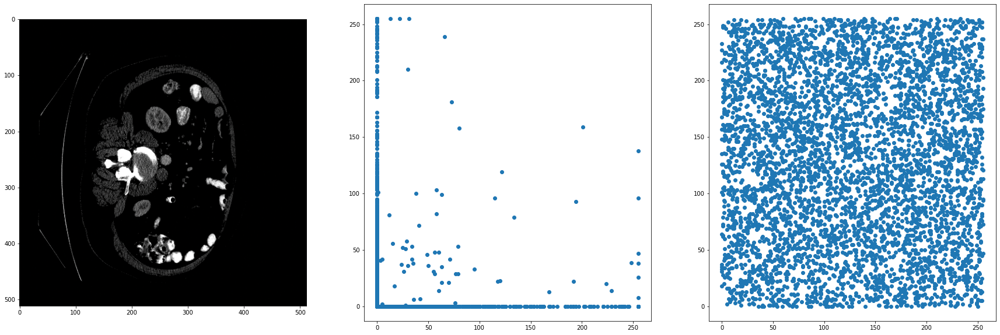

picName='10004.png'
psnr(org, img)=56.08702009573293
ssim(org, img, channel_axis=2)=0.9975489470420689
npcr=0.9961945214562682
uaci=0.33397093376392756
entropy_plain=1.472543704644984
entropy=7.999055957221374
corr_plain=0.9773526905048404
correlation=-0.0013489440067071597
cr=0.26463953653971356
nc=1.0
ber=0.0
enc_time=4.10588359999997
dec_time=2.982587800000033


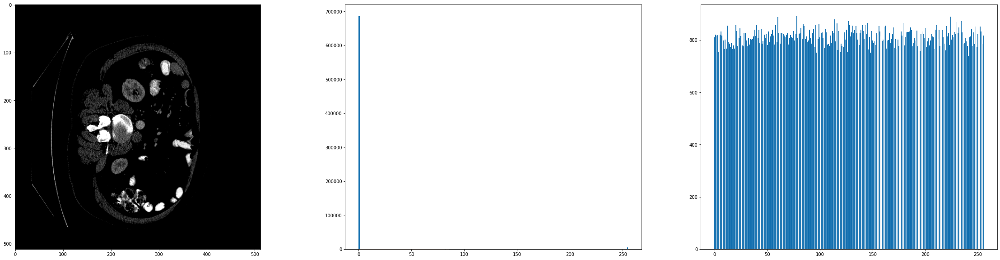

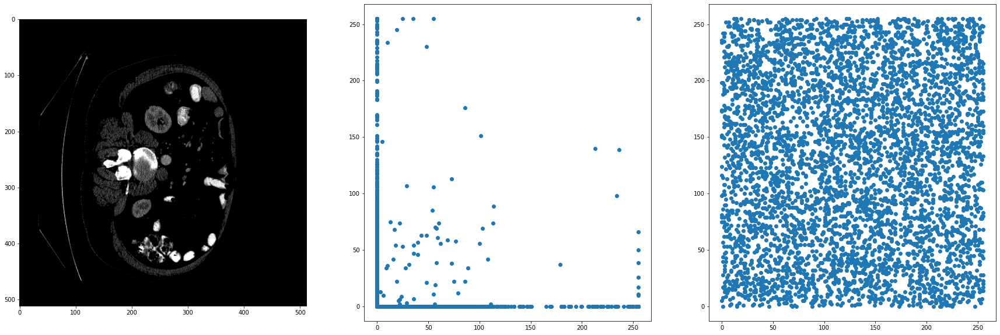

picName='10005.png'
psnr(org, img)=56.11119864982311
ssim(org, img, channel_axis=2)=0.9975580469240432
npcr=0.9959913985086278
uaci=0.3343987816150305
entropy_plain=1.4817042441945705
entropy=7.99903000563143
corr_plain=0.9777848745309081
correlation=-0.0013722585708498408
cr=0.2655042012532552
nc=1.0
ber=0.0
enc_time=4.171550499999967
dec_time=3.135028899999952


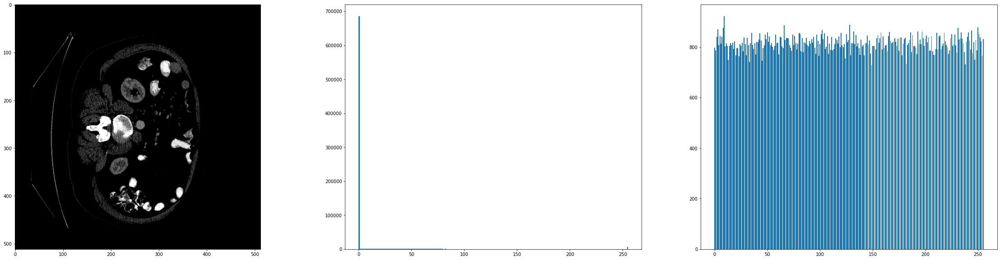

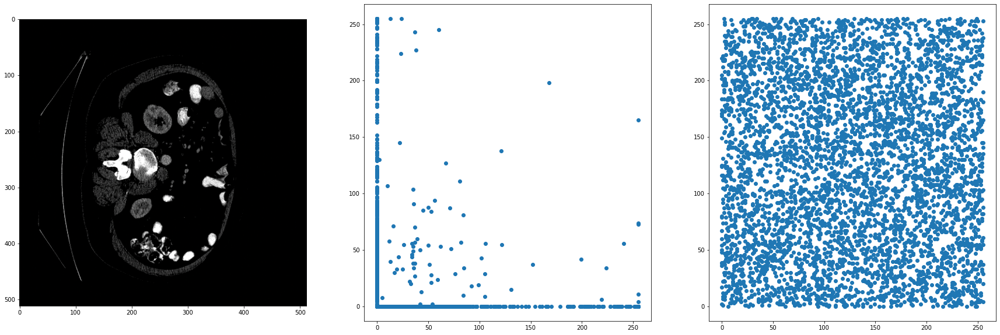

,Image,Size,PSNR,SSIM,NPCR,UACI,Entropy Plain,Entropy,Correlation Plain,Correlation,CR,NC,BER,Enc time,Dec time
0,1.png,512x512x3,55.903379,0.997576,0.996123,0.334033,1.808116,7.999201,0.965208,0.001695,0.282370,1.0,0.0,4.219196,3.056685
1,10.png,512x512x3,55.768087,0.997647,0.996091,0.333851,2.012476,7.999172,0.980122,0.001277,0.293757,1.0,0.0,4.286645,3.251377
2,100.png,512x512x3,55.881347,0.997535,0.995789,0.334005,1.692169,7.999041,0.972699,-0.001408,0.271178,1.0,0.0,4.121095,3.008067
3,1000.png,512x512x3,55.818507,0.997639,0.996161,0.334488,2.130441,7.999209,0.981642,0.000775,0.295146,1.0,0.0,4.262577,3.162794
4,10000.png,512x512x3,56.105756,0.997519,0.996108,0.335493,1.411354,7.999113,0.977390,0.000225,0.260735,1.0,0.0,4.110367,3.387608
5,10001.png,512x512x3,56.086089,0.997525,0.996251,0.334608,1.428580,7.999063,0.978550,-0.000855,0.262180,1.0,0.0,4.101209,2.936989
6,10002.png,512x512x3,56.102155,0.997526,0.996046,0.333963,1.435786,7.999170,0.974593,0.000072,0.262740,1.0,0.0,4.100154,2.926227
7,10003.png,512x512x3,56.102120,0.997539,0.996032,0.335117,1.458715,7.999015,0.976918,-0.000611,0.263715,1.0,0.0,4.093143,2.994618
8,10004.png,512x512x3,56.087020,0.997549,0.996195,0.333971,1.472544,7.999056,0.977353,-0.001349,0.264640,1.0,0.0,4.105884,2.982588
9,10005.png,512x512x3,56.111199,0.997558,0.995991,0.334399,1.481704,7.999030,0.977785,-0.001372,0.265504,1.0,0.0,4.171550,3.135029


In [23]:
runTests("colon", data)

Tests:   0%|          | 0/16 [00:00<?, ?it/s]

C:\Users\ADMIN\AppData\Local\Temp/ipykernel_2152/2312287941.py:204: RuntimeWarning: overflow encountered in ubyte_scalars
  data[i] = (data[i] + data[i-1] + ra[i]) % 256
C:\Users\ADMIN\AppData\Local\Temp/ipykernel_2152/2312287941.py:215: RuntimeWarning: overflow encountered in ubyte_scalars
  data[i] = (data[i] - data[i-1] - ra[i]) % 256


picName='volume-0_slice_0.jpg'
psnr(org, img)=48.75301168621816
ssim(org, img, channel_axis=2)=0.9915611764748579
npcr=0.9960810488676997
uaci=0.3337080838533268
entropy_plain=5.225449788215725
entropy=7.998309015327943
corr_plain=0.5755120809271929
correlation=0.0012412059091796322
cr=0.5334218343098959
nc=1.0
ber=0.0
enc_time=1.4980096000000032
dec_time=1.0587258999999989


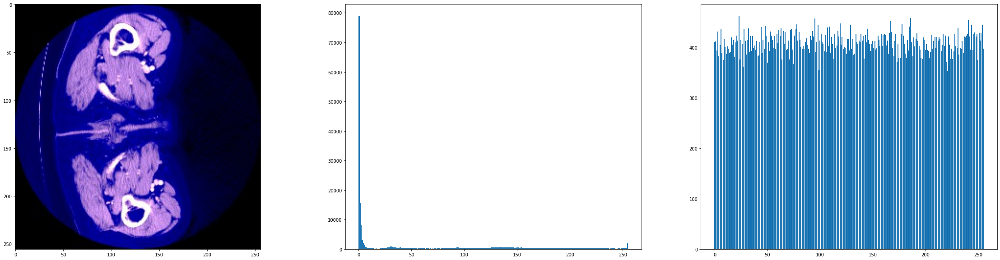

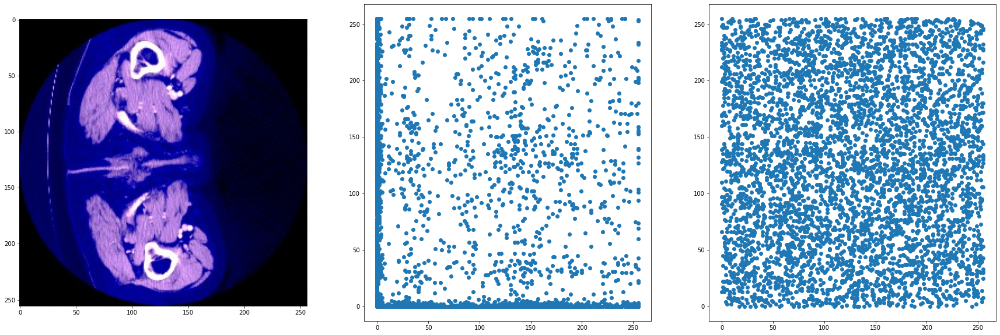

picName='volume-0_slice_1.jpg'
psnr(org, img)=48.698446141019566
ssim(org, img, channel_axis=2)=0.9917265652538139
npcr=0.9959153255476105
uaci=0.33477476117704025
entropy_plain=5.282892286819714
entropy=7.998092955143494
corr_plain=0.624623401830905
correlation=0.0032725829880048173
cr=0.5391743977864584
nc=1.0
ber=0.0
enc_time=1.3882753999999977
dec_time=1.0937052999999963


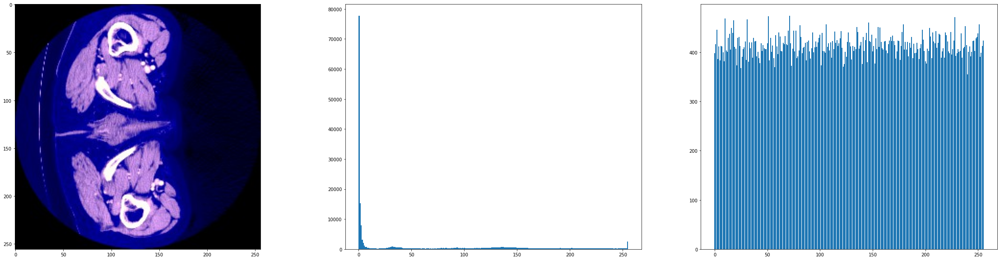

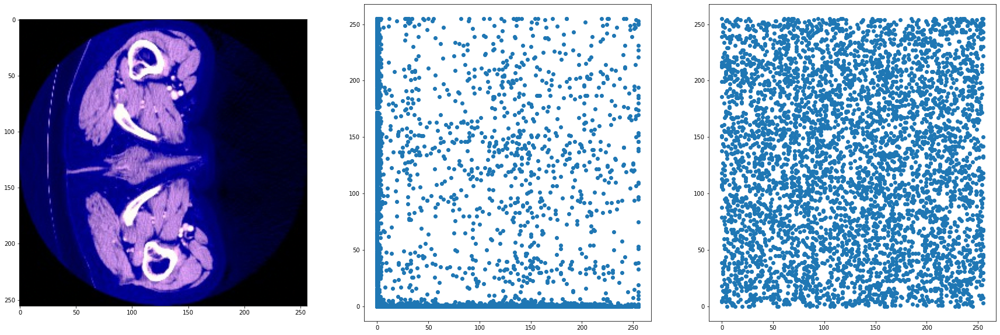

picName='volume-0_slice_16.jpg'
psnr(org, img)=48.62897152688822
ssim(org, img, channel_axis=2)=0.9920977108942587
npcr=0.9960375296046639
uaci=0.3338873826083539
entropy_plain=5.433736229255307
entropy=7.998252333723606
corr_plain=0.6949619266568517
correlation=-0.0011292757384735266
cr=0.5583699544270834
nc=1.0
ber=0.0
enc_time=1.395200100000011
dec_time=1.0856237999999934


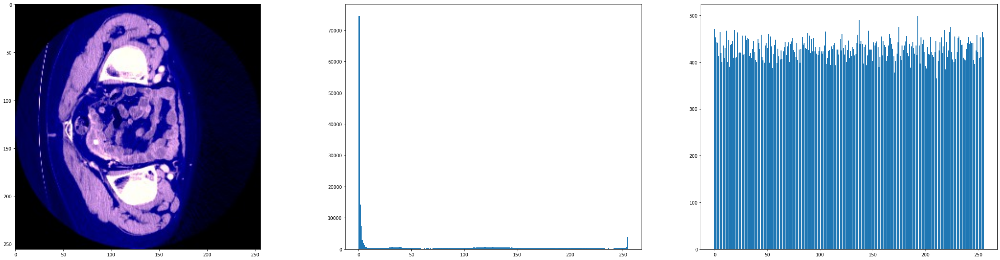

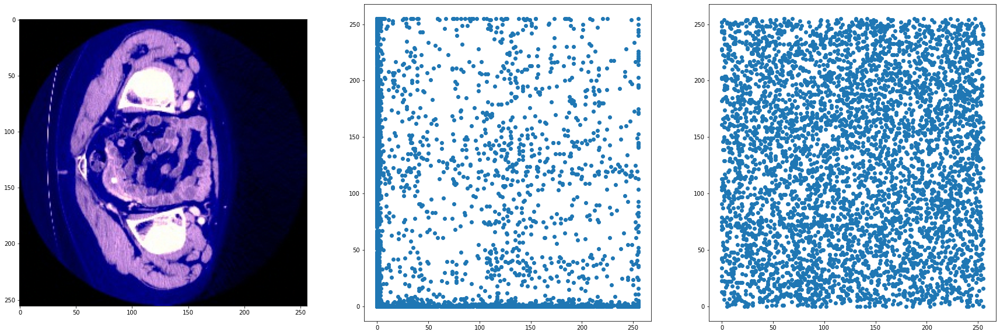

picName='volume-0_slice_17.jpg'
psnr(org, img)=48.58700918988423
ssim(org, img, channel_axis=2)=0.9919993552684602
npcr=0.9965131283919207
uaci=0.33536824798833287
entropy_plain=5.412909982356201
entropy=7.998311716855873
corr_plain=0.6898556629098122
correlation=0.0023637901577595196
cr=0.5557607014973959
nc=1.0
ber=0.0
enc_time=1.3997475999999978
dec_time=1.096840499999999


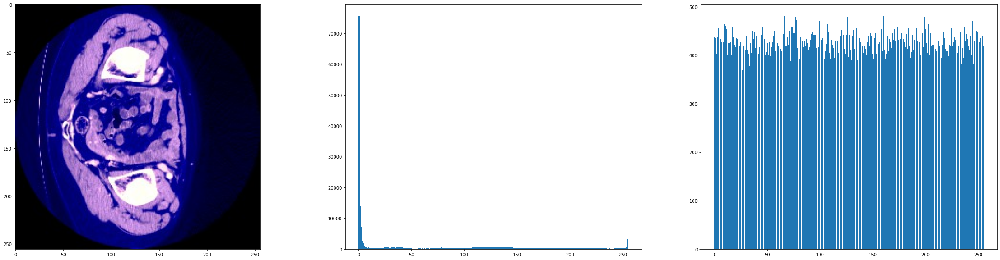

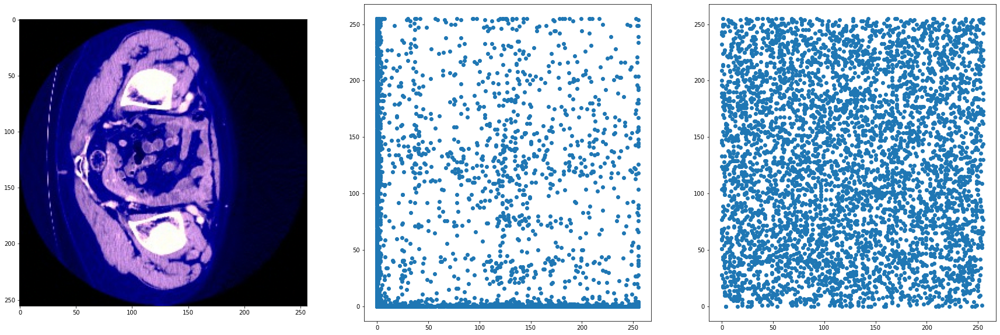

picName='volume-0_slice_18.jpg'
psnr(org, img)=48.60409527292384
ssim(org, img, channel_axis=2)=0.9922709214162267
npcr=0.99592307969838
uaci=0.3352714091373101
entropy_plain=5.44211622650821
entropy=7.99818104471994
corr_plain=0.6890026630370705
correlation=-0.00020560383365504783
cr=0.56390380859375
nc=1.0
ber=0.0
enc_time=1.3848011999999983
dec_time=1.0930098999999984


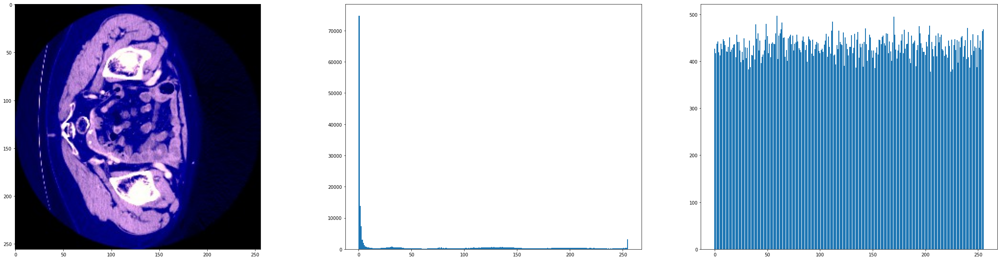

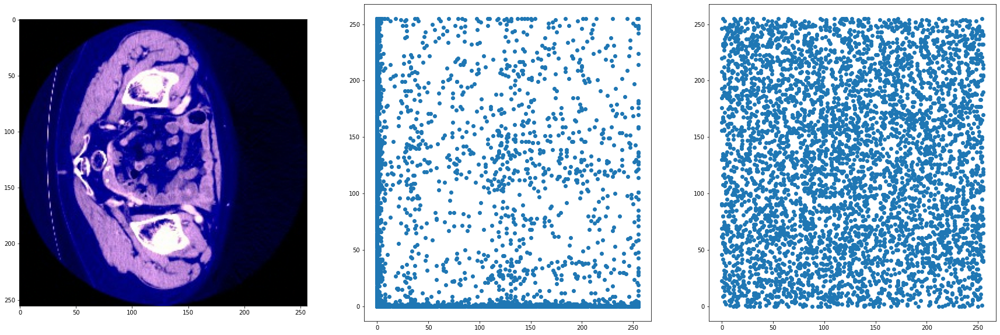

picName='volume-0_slice_19.jpg'
psnr(org, img)=48.630210414370964
ssim(org, img, channel_axis=2)=0.992365317109229
npcr=0.9960355188806171
uaci=0.3336004460085227
entropy_plain=5.404119726432123
entropy=7.998154643052262
corr_plain=0.6732460954569135
correlation=-0.004214121030211583
cr=0.5670674641927084
nc=1.0
ber=0.0
enc_time=1.4146822999999955
dec_time=1.1040463000000074


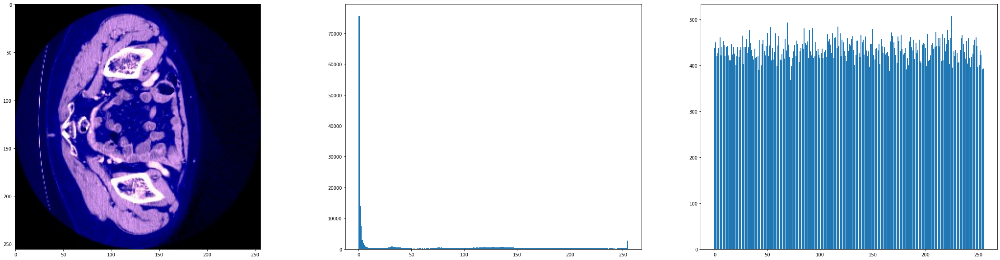

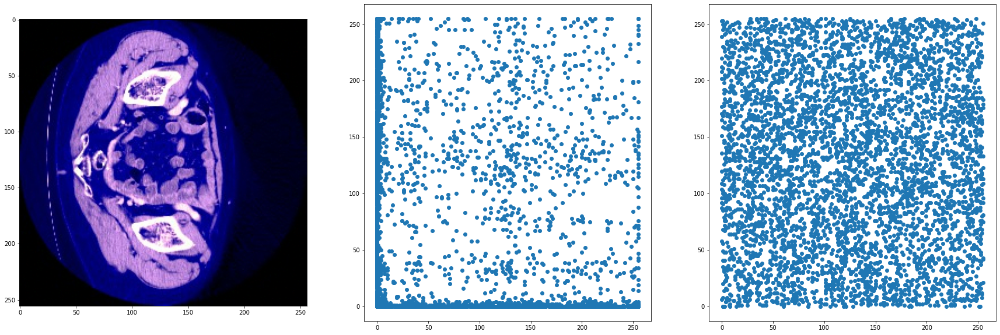

picName='volume-0_slice_2.jpg'
psnr(org, img)=48.665668097026895
ssim(org, img, channel_axis=2)=0.9917807998256783
npcr=0.9961492670585609
uaci=0.33384756685619404
entropy_plain=5.314605050802054
entropy=7.998313773666221
corr_plain=0.6380825440614812
correlation=0.002110817878016648
cr=0.5468343098958334
nc=1.0
ber=0.0
enc_time=1.3800323999999904
dec_time=1.1018557000000015


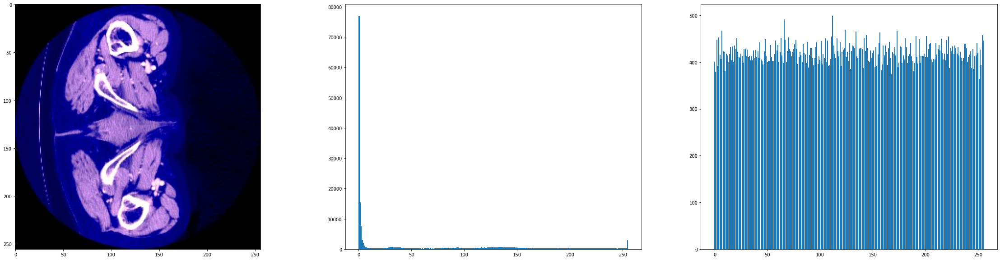

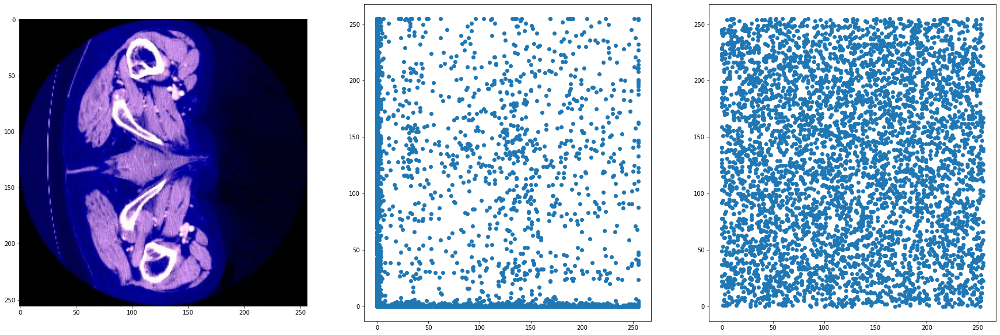

picName='volume-0_slice_3.jpg'
psnr(org, img)=48.72878550496277
ssim(org, img, channel_axis=2)=0.9917761910811606
npcr=0.9963921408180914
uaci=0.33360900965651136
entropy_plain=5.302814436345058
entropy=7.998160040364347
corr_plain=0.6473425600801346
correlation=-0.003832258796795081
cr=0.5469919840494791
nc=1.0
ber=0.0
enc_time=1.3915578999999951
dec_time=1.0936315000000008


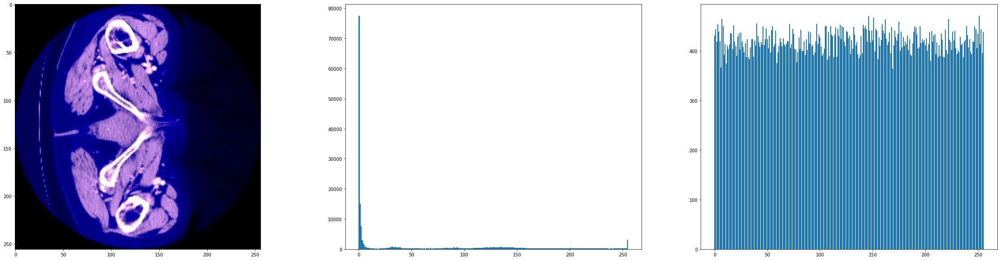

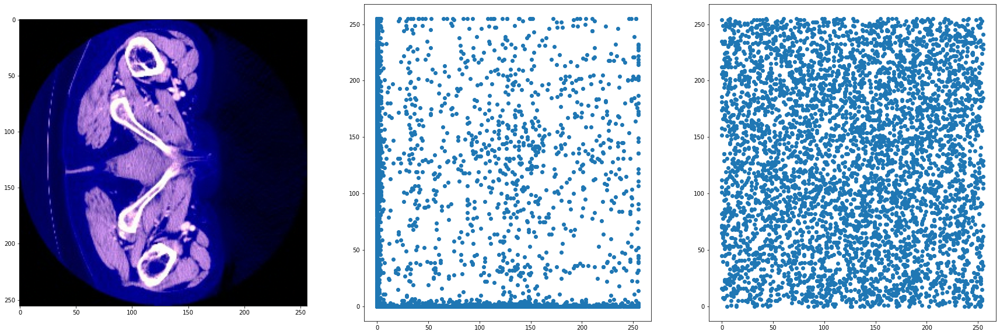

picName='volume-0_slice_32.jpg'
psnr(org, img)=48.666492661734
ssim(org, img, channel_axis=2)=0.9920420621562686
npcr=0.9961181838251527
uaci=0.3349072707307958
entropy_plain=5.222454488009492
entropy=7.998345133007064
corr_plain=0.6410063812739928
correlation=-0.0023088391902613835
cr=0.5529378255208334
nc=1.0
ber=0.0
enc_time=1.3887618999999916
dec_time=1.096907299999998


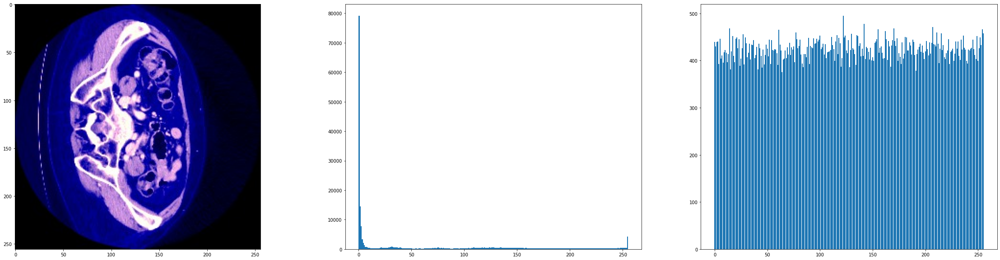

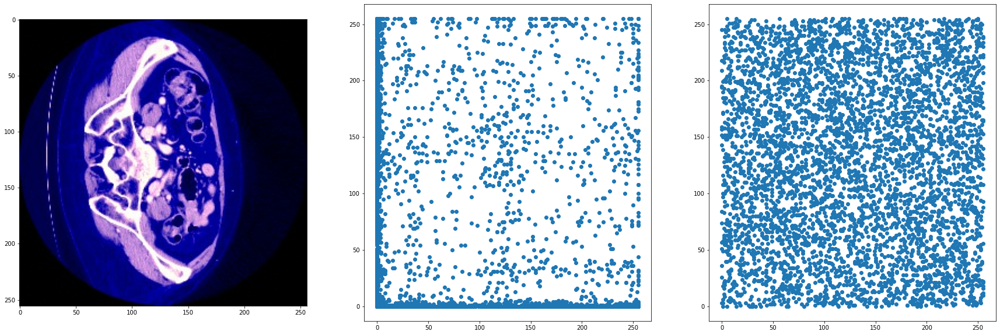

picName='volume-0_slice_33.jpg'
psnr(org, img)=48.69688565083309
ssim(org, img, channel_axis=2)=0.9918361973813626
npcr=0.9959314098872313
uaci=0.3346921163917663
entropy_plain=5.1732554258408125
entropy=7.998123862671703
corr_plain=0.6302050069684345
correlation=-0.00045183116512038837
cr=0.5475565592447916
nc=1.0
ber=0.0
enc_time=1.4077372999999938
dec_time=1.2205406000000067


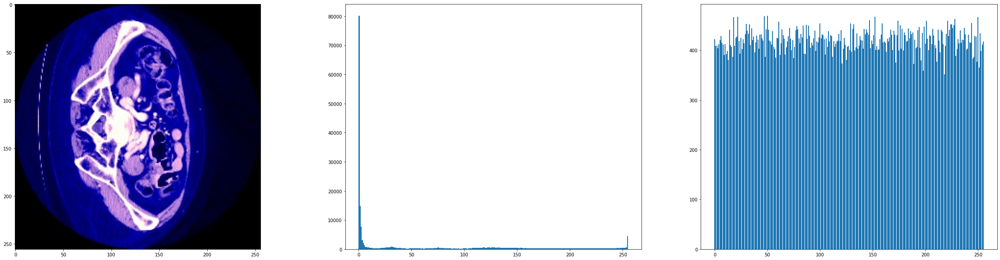

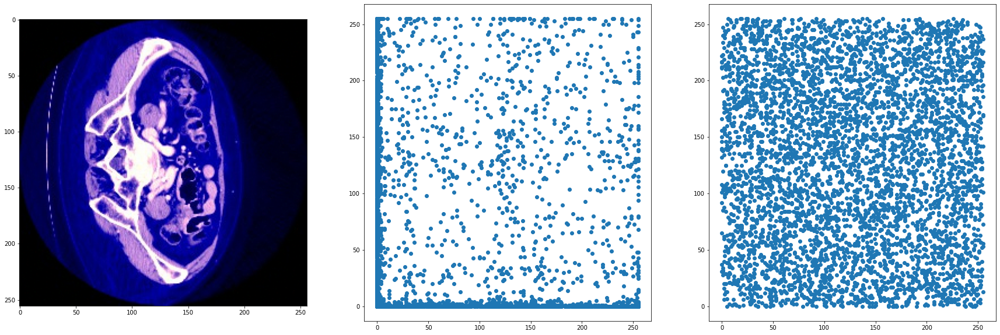

picName='volume-0_slice_34.jpg'
psnr(org, img)=48.69286116805603
ssim(org, img, channel_axis=2)=0.991951972835467
npcr=0.9959295068835112
uaci=0.3361757564666359
entropy_plain=5.168140271128308
entropy=7.998373233234656
corr_plain=0.6300507826285647
correlation=-0.0013646072302502727
cr=0.546051025390625
nc=1.0
ber=0.0
enc_time=1.5126002000000085
dec_time=1.1643149999999878


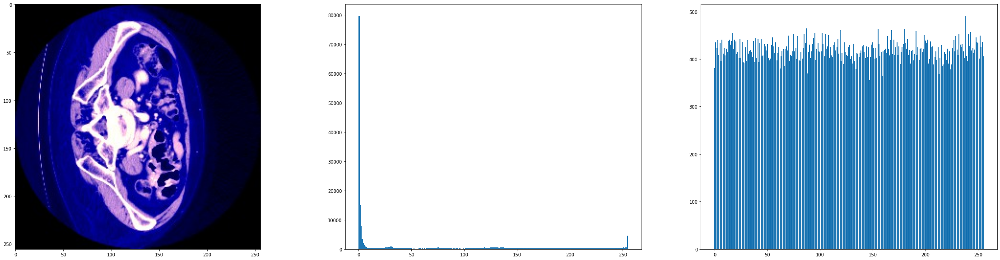

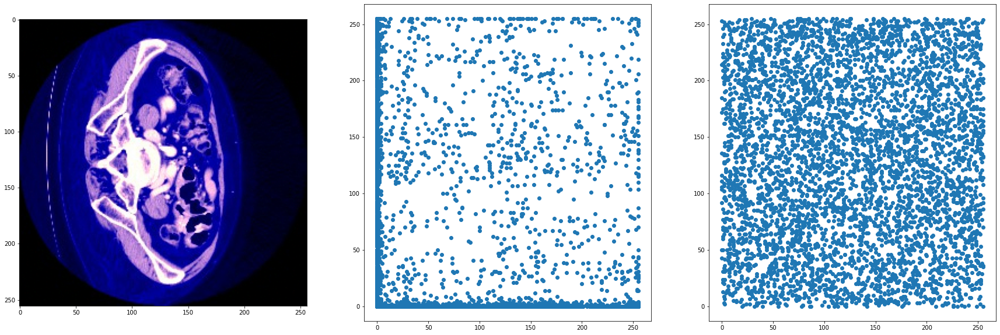

picName='volume-0_slice_35.jpg'
psnr(org, img)=48.690724677493776
ssim(org, img, channel_axis=2)=0.9919109169055594
npcr=0.9963703038467295
uaci=0.33466954136841087
entropy_plain=5.14652467965233
entropy=7.9984994764668205
corr_plain=0.617188494863761
correlation=-0.006185894849436298
cr=0.543701171875
nc=1.0
ber=0.0
enc_time=1.3920894000000033
dec_time=1.063800299999997


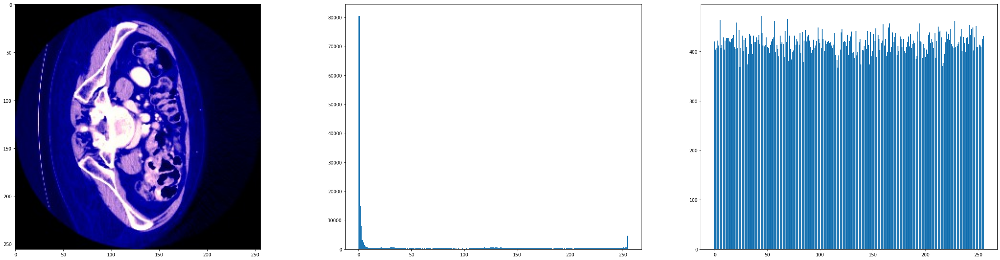

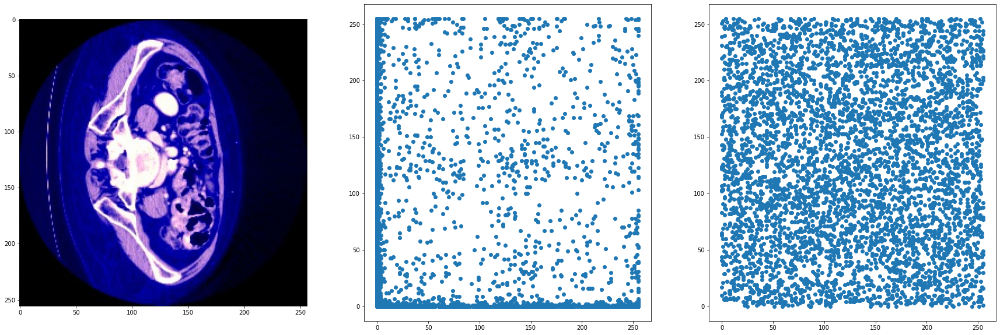

picName='volume-0_slice_48.jpg'
psnr(org, img)=48.682640667507435
ssim(org, img, channel_axis=2)=0.9916079354425489
npcr=0.9960417382015184
uaci=0.3343580116415724
entropy_plain=5.201956948129053
entropy=7.998431916763723
corr_plain=0.6901196319647964
correlation=0.0015901840735942454
cr=0.53326416015625
nc=1.0
ber=0.0
enc_time=1.3627706000000046
dec_time=1.0708061999999927


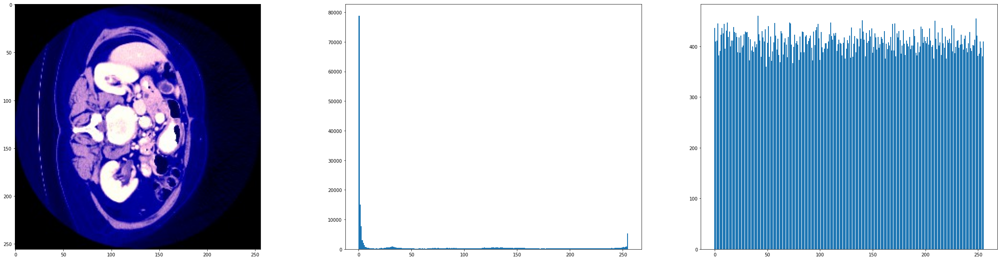

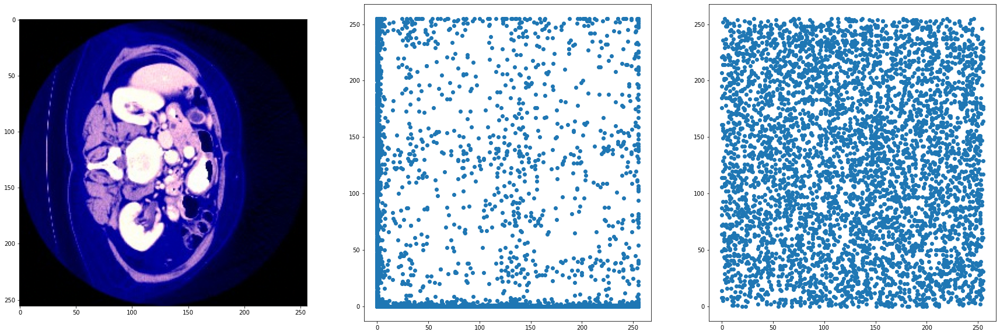

picName='volume-0_slice_49.jpg'
psnr(org, img)=48.66724240189037
ssim(org, img, channel_axis=2)=0.9916194470344039
npcr=0.9959874405942003
uaci=0.33501610473537075
entropy_plain=5.234085431615985
entropy=7.998324133535232
corr_plain=0.6859531761034454
correlation=0.0022251493693789936
cr=0.5361887613932291
nc=1.0
ber=0.0
enc_time=1.3865129999999795
dec_time=1.0796684999999968


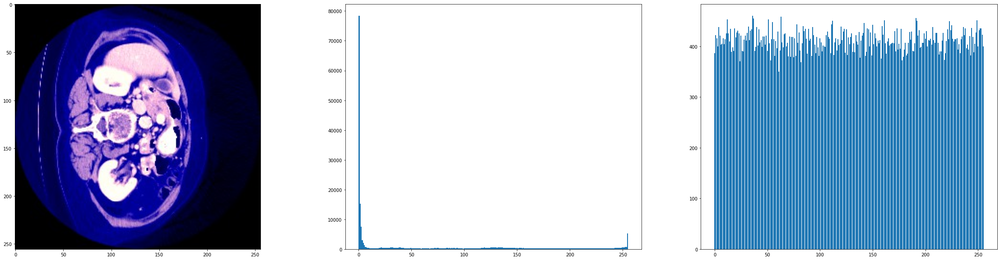

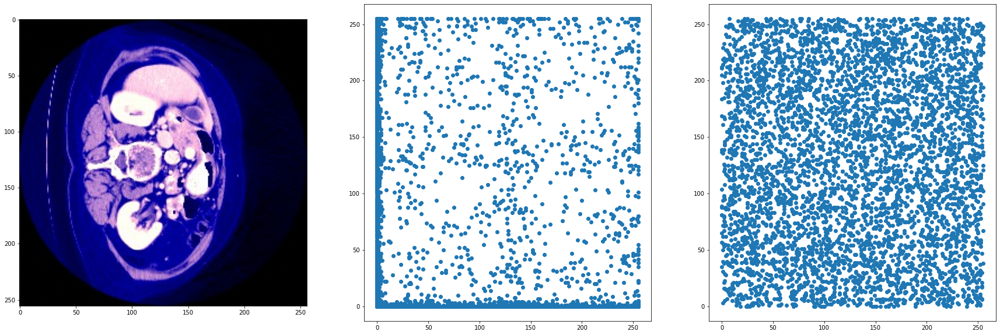

picName='volume-0_slice_50.jpg'
psnr(org, img)=48.690297505476714
ssim(org, img, channel_axis=2)=0.9914692471737481
npcr=0.9960265533215531
uaci=0.33458612271500127
entropy_plain=5.219375920537152
entropy=7.998519136534783
corr_plain=0.7032424083970459
correlation=-0.0010954364318757539
cr=0.5325063069661459
nc=1.0
ber=0.0
enc_time=1.3233240000000137
dec_time=1.0712642999999957


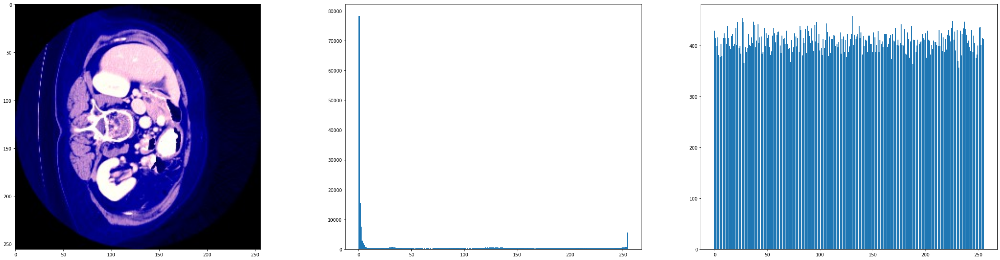

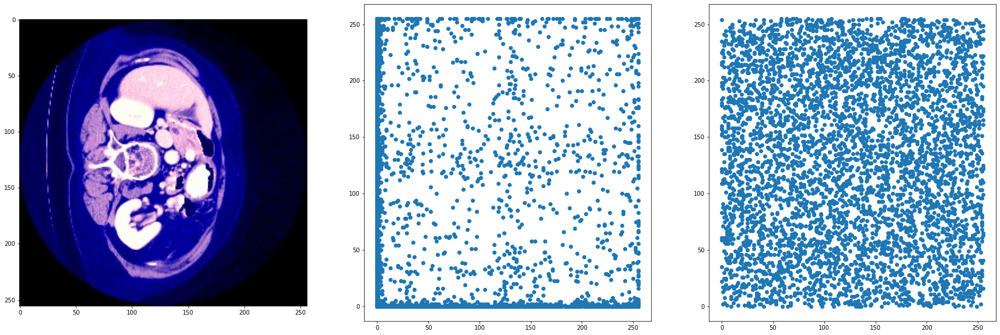

picName='volume-0_slice_51.jpg'
psnr(org, img)=48.67867947595543
ssim(org, img, channel_axis=2)=0.991465374393974
npcr=0.9961258802648906
uaci=0.3342195574006239
entropy_plain=5.246573196372671
entropy=7.998199016141283
corr_plain=0.7235654417959279
correlation=-0.0025452702843045028
cr=0.5330301920572916
nc=1.0
ber=0.0
enc_time=1.3918288000000132
dec_time=1.077254499999981


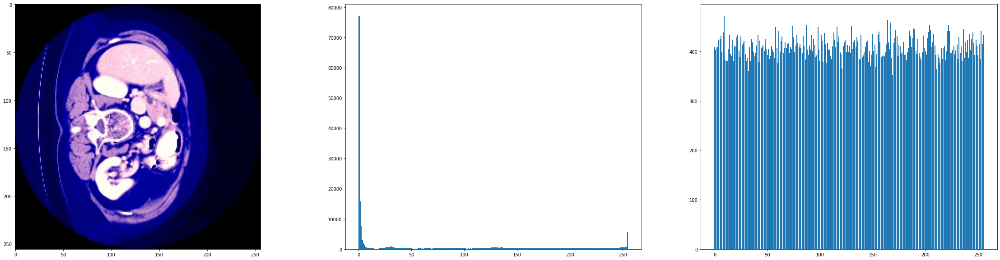

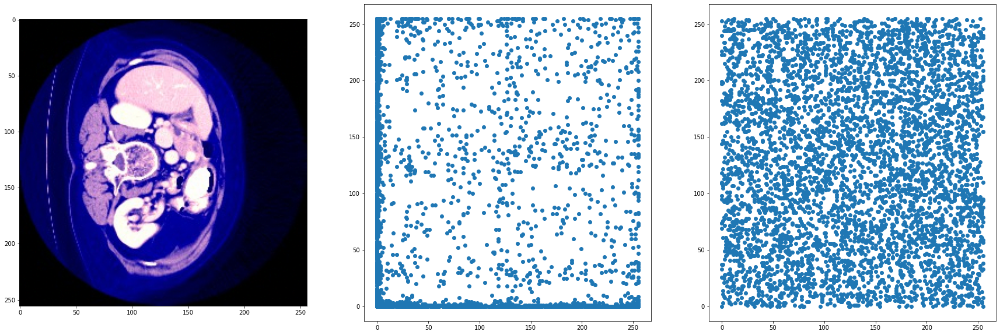

,Image,Size,PSNR,SSIM,NPCR,UACI,Entropy Plain,Entropy,Correlation Plain,Correlation,CR,NC,BER,Enc time,Dec time
0,volume-0_slice_0.jpg,256x256x3,48.753012,0.991561,0.996081,0.333708,5.225450,7.998309,0.575512,0.001241,0.533422,1.0,0.0,1.498010,1.058726
1,volume-0_slice_1.jpg,256x256x3,48.698446,0.991727,0.995915,0.334775,5.282892,7.998093,0.624623,0.003273,0.539174,1.0,0.0,1.388275,1.093705
2,volume-0_slice_16.jpg,256x256x3,48.628972,0.992098,0.996038,0.333887,5.433736,7.998252,0.694962,-0.001129,0.558370,1.0,0.0,1.395200,1.085624
3,volume-0_slice_17.jpg,256x256x3,48.587009,0.991999,0.996513,0.335368,5.412910,7.998312,0.689856,0.002364,0.555761,1.0,0.0,1.399748,1.096840
4,volume-0_slice_18.jpg,256x256x3,48.604095,0.992271,0.995923,0.335271,5.442116,7.998181,0.689003,-0.000206,0.563904,1.0,0.0,1.384801,1.093010
5,volume-0_slice_19.jpg,256x256x3,48.630210,0.992365,0.996036,0.333600,5.404120,7.998155,0.673246,-0.004214,0.567067,1.0,0.0,1.414682,1.104046
6,volume-0_slice_2.jpg,256x256x3,48.665668,0.991781,0.996149,0.333848,5.314605,7.998314,0.638083,0.002111,0.546834,1.0,0.0,1.380032,1.101856
7,volume-0_slice_3.jpg,256x256x3,48.728786,0.991776,0.996392,0.333609,5.302814,7.998160,0.647343,-0.003832,0.546992,1.0,0.0,1.391558,1.093632
8,volume-0_slice_32.jpg,256x256x3,48.666493,0.992042,0.996118,0.334907,5.222454,7.998345,0.641006,-0.002309,0.552938,1.0,0.0,1.388762,1.096907
9,volume-0_slice_33.jpg,256x256x3,48.696886,0.991836,0.995931,0.334692,5.173255,7.998124,0.630205,-0.000452,0.547557,1.0,0.0,1.407737,1.220541


In [13]:
runTests("cover", data)

In [18]:
img = np.array(Image.open("cover/volume-0_slice_0.jpg").convert("RGB"))
n, bins = np.histogram(img.flatten(), bins=256)